# EQ Challenge Notebook

## Content
0. Data Collection
1. Clean-Up
2. Label
3. Analysis
4. Data Science/Engineering Tracks
    a. Model
        1- Visualize
        2- Bonus
    b. Pipeline Dependency
  

## 0. Data Collection 

Import and Install necessary libraries.

In [7]:
#!pip install haversine
#!pip install folium
#!pip install graphframes

In [69]:
#!pip install nbconvert

In [10]:

from pyspark.sql import SparkSession
import pyspark.sql.functions as f
from pyspark.sql.types import *
from pyspark.sql import SQLContext
from pyspark.ml.feature import IndexToString, StringIndexer, OneHotEncoder
from pyspark.streaming import StreamingContext
from pyspark.sql.window import Window
import os
import numpy as np
import haversine as hs
import folium
from itertools import chain
import math
import numpy as np
import pandas as pd
from scipy.stats import norm
from  time import sleep


In [11]:
# Starting Spark Session
spark = SparkSession.builder \
       .master("local") \
       .appName("EQ Challenge") \
       .config("spark.executor.memory", "3g")\
       .config("spark.driver.memory", "3g")\
       .config("spark.sql.broadcastTimeout", "36000")\
       .config("spark.cores.max", "4")\
        .config("spark.jars", "graphframes-0.8.1-spark2.4-s_2.12.jar")\
       .getOrCreate()
          
sc = spark.sparkContext
sc.addPyFile('graphframes-0.8.1-spark2.4-s_2.12.jar')
sc.setCheckpointDir(inputPath)
from graphframes import GraphFrame
from graphframes.lib import Pregel
sqlContext = SQLContext(sc)
spark.sparkContext._conf.getAll()  # check the config
spark.sparkContext.version

'3.0.0'

In [12]:
# Importing Data

inputPath=os.getcwd()+ '/data/'
df = spark.read.options(
    header='True',
    inferSchema='True',
    delimiter=',',
).csv(os.path.join(inputPath+'DataSample.csv'))

poi = spark.read.options(header='True', inferSchema='True', delimiter=',').csv(os.path.join(inputPath,'POIList.csv'))

In [13]:
# Take a look on the Schema
df.printSchema()
poi.printSchema()

root
 |-- _ID: integer (nullable = true)
 |--  TimeSt: string (nullable = true)
 |-- Country: string (nullable = true)
 |-- Province: string (nullable = true)
 |-- City: string (nullable = true)
 |-- Latitude: double (nullable = true)
 |-- Longitude: double (nullable = true)

root
 |-- POIID: string (nullable = true)
 |--  Latitude: double (nullable = true)
 |-- Longitude: double (nullable = true)



In [14]:
# Strip Column names
df = df.select([f.col(cl).alias(cl.replace(' ', '')) for cl in df.columns])
df = df.select([f.col(cl).alias(cl.replace('_', '')) for cl in df.columns])
poi = poi.select([f.col(cl).alias(cl.replace(' ', '')) for cl in poi.columns])

In [15]:
# look at some data
df.show(n=5)
original_df_count=df.count()
print('Number of Records:',original_df_count)

+-------+--------------------+-------+--------+---------+--------+---------+
|     ID|              TimeSt|Country|Province|     City|Latitude|Longitude|
+-------+--------------------+-------+--------+---------+--------+---------+
|4516516|2017-06-21 00:00:...|     CA|      ON| Waterloo|43.49347|-80.49123|
|4516547|2017-06-21 18:00:...|     CA|      ON|   London| 42.9399| -81.2709|
|4516550|2017-06-21 15:00:...|     CA|      ON|   Guelph| 43.5776| -80.2201|
|4516600|2017-06-21 15:00:...|     CA|      ON|Stratford| 43.3716| -80.9773|
|4516613|2017-06-21 15:00:...|     CA|      ON|Stratford| 43.3716| -80.9773|
+-------+--------------------+-------+--------+---------+--------+---------+
only showing top 5 rows

Number of Records: 22025


In [16]:
poi.show()
original_poi_count=poi.count()
print('Number of POI\'s:',original_poi_count)

+-----+---------+-----------+
|POIID| Latitude|  Longitude|
+-----+---------+-----------+
| POI1|53.546167|-113.485734|
| POI2|53.546167|-113.485734|
| POI3|45.521629| -73.566024|
| POI4| 45.22483| -63.232729|
+-----+---------+-----------+

Number of POI's: 4


## 1. Clean-up Data

Records that have identical geoinfo and timest as are considered suspicious and should be removed

In [17]:
df = df.dropDuplicates(['TimeSt','Latitude','Longitude'])
print('Removed',original_df_count-df.count(),'suspecious records')

Removed 2026 suspecious records


Remove Duplicate POI with the same location

In [18]:
poi = poi.dropDuplicates(poi.drop('POIID').columns)
print('Removed',original_poi_count-poi.count(),'redundent POI')

Removed 1 redundent POI


## 2. Label

Assign each request to the closest  POI

In [19]:
# first create a map type column called 'map'
#make_map = udf(lambda x, y: dict(zip(x, y)), MapType(DoubleType(), DoubleType()))
#df_coor=df.select('ID',make_map(col('Latitude'), col('Longitude')).alias('coor'))


In [20]:
def distance_from(lat1, long1, lat2, long2): 
    """ defining a  function to calculate distance between two locations
        loc1= location of an existing POI
        loc2= location of customer"""
    # convert decimal degrees to radians 
    lat1, long1, lat2, long2 = map(f.toRadians, [lat1, long1, lat2, long2])
    # Haversine formula https://www.movable-type.co.uk/scripts/latlong.html
    distlon = long2 - long1 
    distlat = lat2 - lat1 
    a = f.sin(distlat/2)**2 + f.cos(lat1) * f.cos(lat2) * f.sin(distlon/2)**2
    c=2 * f.asin(f.sqrt(a)) 
    # Radius of the earth in kilometers is 6371
    distKm = 6371* c
    return f.round(f.abs(distKm), 4)

In [21]:
# Combine POI table with Requests Table by cross join
comb_df = df.select(['ID', 'Latitude', 'Longitude']).crossJoin(
            poi.withColumnRenamed('Latitude', 'POI_LAT')
                .withColumnRenamed('Longitude', 'POI_LON')
        )
# Calculate the distance from request to each POI using Haversine formula
comb_df = comb_df.withColumn(
            'Distance', distance_from('Latitude','Longitude','POI_LAT','POI_LON'))
# Group request location and calculate the minimum distance to POI
group_data = comb_df.groupBy(['Latitude', 'Longitude']).agg(
            f.min('Distance')).withColumnRenamed('min(Distance)', 'Distance')
# Left join the minimum distances grouped table to the combined table 
comb_df = comb_df.join(group_data,
                                 on=['Latitude', 'Longitude', 'Distance'],
                                 how='left_semi')
# left join the latest combined table to the initial request table on ID 
comb_df = df.join(
            comb_df.select(['ID', 'POIID', 'Distance']), on=['ID'],
            how='left'
        )
# Show final table sample
comb_df.show(n=5)

+-------+--------------------+-------+--------+-------------+--------+---------+-----+--------+
|     ID|              TimeSt|Country|Province|         City|Latitude|Longitude|POIID|Distance|
+-------+--------------------+-------+--------+-------------+--------+---------+-----+--------+
|4517905|2017-06-21 17:00:...|     CA|      ON|      Windsor| 42.2957| -82.9599| POI3|832.9559|
|4526426|2017-06-21 17:00:...|     CA|      QC|Saint-Nicolas|46.72072|-71.30409| POI3|219.4615|
|4535091|2017-06-21 11:00:...|     CA|      AB|      Calgary|  51.049|-113.9622| POI1|279.5545|
|4545807|2017-06-21 04:01:...|     CA|      ON|      Markham|43.85883|-79.29809| POI3|489.2499|
|4559622|2017-06-21 18:01:...|     CA|      ON|     Kingston| 44.2647| -76.5504| POI3|273.4697|
+-------+--------------------+-------+--------+-------------+--------+---------+-----+--------+
only showing top 5 rows



In [22]:
comb_df.count()

19999

In [23]:
# Create Checkpoint

#comb_df.rdd.saveAsPickleFile('Pickled/com_df.pkl')


In [24]:
# Load Check point

#pickleRdd = sc.pickleFile('com_df.pkl').collect()
#comb_df= spark.createDataFrame(pickleRdd)

## 3. Analysis

Calculate Average Distance, Standard Deviation and density of each POI.

In [25]:
group_df = comb_df.groupBy(['POIID'])

analys_poi = group_df.agg(
             f.mean('Distance'), f.stddev('Distance'),f.max('Distance'),f.count('POIID') ) \
            .withColumnRenamed('avg(Distance)', 'Average Distance') \
            .withColumnRenamed('stddev(Distance)', 'SD Distance') \
            .withColumnRenamed('max(Distance)', 'Radius') \
            .withColumnRenamed('count(POIID)', 'Count')

analys_poi = analys_poi.withColumn('Density', f.col('Count') / (math.pi * f.col('Radius')**2))
analys_poi.show()

+-----+------------------+---------------------+----------+-----+--------------------+
|POIID|  Average Distance|stddev_samp(Distance)|    Radius|Count|             Density|
+-----+------------------+---------------------+----------+-----+--------------------+
| POI4|497.27872746331195|   1472.9378033111789| 9349.5728|  477|1.736940618101474...|
| POI1| 301.9068558856792|      412.43003446935|11531.8208| 9727|2.328269629635223...|
| POI3| 451.5275540786115|   223.35055601525525|  1474.581| 9795|0.001433894834424...|
+-----+------------------+---------------------+----------+-----+--------------------+



## 4. Data Science/Engineering Tracks

### 4a. Model

Popularity index (PI) in finance is defined as the ratio of portion sales for a given menu item to total portion sales.
In this question, we will consider the menu items as Point of Interests (POI's) and the sales as the request to a given POI.
The conventional way to solve PI is as follows: 
PI(POIn)=Sum(Requests to POIn) / Sum(Requests to all POI's)

As to show some of my skills in Machine Learning and to apply a more accurate technique that can solve PI as data streams to the Dataframe, I will apply a reinforcement Learning algorithm (**"The multi-armed bandit model"**).

#### The Multi-armed Bandit Model

A multi-armed bandit is a complicated slot machine wherein instead of 1, there are several levers which a gambler can pull, with each lever giving a different return. The probability distribution for the reward corresponding to each lever is different and is unknown to the gambler. The task is to identify which lever to pull in order to get a maximum reward after a given set of trials. This problem statement is like a single step Markov decision process, Each arm chosen is equivalent to an action, which then leads to an immediate reward.

To translate this problem to our case, *bandits arms* are considered *POI's* and *gamblers* are considered *requests* to a given POI.

For the sake of context, this assumption is based on my understanding of the challenge problem. Furthermore, we considering **POI Density** or simply *Number of Requests/ Area* as the main factor of popularity instead of **Number of Requests** which will lead to a different ranking index that is affected by POI coverage area.

One way to implement Multi-armed Bandit is by **Upper Confidence Bound** algorithm.
Upper Confidence Bound (UCB) is the most widely used solution method for multi-armed bandit problems. This algorithm is based on the principle of optimism in the face of uncertainty. Meaning that, the more uncertain we are about an arm, the more important it becomes to explore that arm.

For example, the following figure shows the Distribution of action-value functions (requests) for 3 different POI's POI1, POI2, and POI3 after several requests. This distribution shows that the action value for POI1 has the highest variance and hence maximum uncertainty.
UCB says that we should choose the POI POI1 and receive a reward making us less uncertain about its action value. For the next request/timestep, if we still are very uncertain about POI11, we will choose it again until the uncertainty is reduced below a threshold.

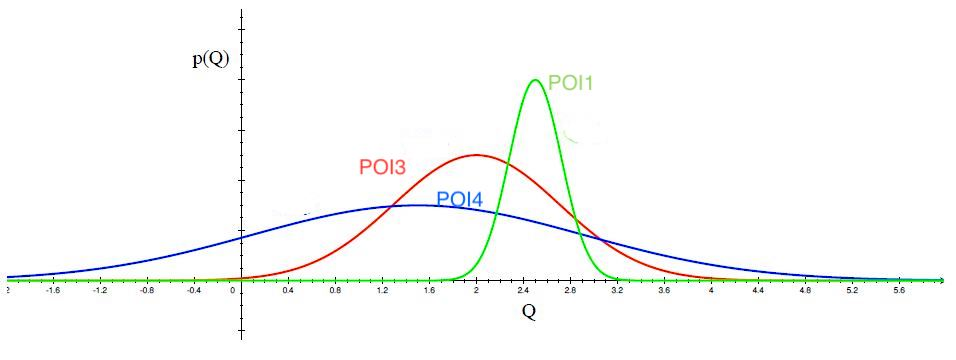

UBC Model:
   1. Play each of the K actions once, giving initial values for mean rewards corresponding to each action POIt
   2. For each round t = K:
       Let Nt(POI) represent the number of times  POI was requested until time t
       select the POI that maximise the following expression:

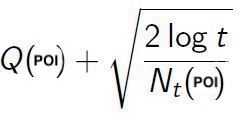

Each time a is selected, the uncertainty is presumably reduced: Nt(a) increments, and, as it appears in the denominator, the uncertainty term decreases.
where Q(POI)is a random exploration factor. 

Let's first, remove the outlier requests (away from Inter Quartile Range IQR) which are too far away from the POI. 
IQR is a measure of statistical dispersion, which is equal to the difference between the 75th percentile and the 25th percentile.
IQR Can  be used to detect request outliers in a few easy and straightforward steps:
1.	Calculate the 1st quartile Q1.
2.	Calculate the 3rd quartile Q3.
3.	Calculate IQR=Q3−Q1.
4.	Calculate the Requests Range:
    - Lower bound: Q1−1.5∗IQR
    - Upper bound: Q3+1.5∗IQR
5.	Remove any points outside the Requests Range as suspected outliers.



In [26]:

def calculate_ReqRang(df):
    # 1. Calculate the 1st quartile Q1.
    # 2. Calculate the 3rd quartile Q3.
    requests = {
    c: dict(
            zip(["q1", "q3"], df.approxQuantile(c, [0.25, 0.75], 0))
        ) for c,d in zip(df.columns, df.dtypes) if d[1] == "double" # Distance should be of type double
    }

    for c in requests:
    # 3. Calculate IQR=Q3−Q1
        iqr = requests[c]['q3'] - requests[c]['q1']
    # 4. Calculate the Requests Range:
        requests[c]['min'] = requests[c]['q1'] - (iqr * 1.5)
        requests[c]['max'] = requests[c]['q3'] + (iqr * 1.5)

    return requests

In [27]:
IQR=calculate_ReqRang(comb_df.select(['Distance']))
IQR

{'Distance': {'q1': 166.0415,
  'q3': 515.1794,
  'min': -357.6653499999999,
  'max': 1038.88625}}

In [28]:
# 5 Remove any points outside the Requests Range considered as suspected outliers.
bounded_df=comb_df.filter(f.col("Distance").between(IQR['Distance']['min'],IQR['Distance']['max']))
print('Number of removed outlaiers requests:',comb_df.count()-bounded_df.count())

Number of removed outlaiers requests: 513


In [29]:
# Create Checkpoint

#bounded_df.rdd.saveAsPickleFile('bounded_df.pkl')

# Load Check point
#pickleRdd = sc.pickleFile('bounded_df.pkl').collect()
#bounded_df= spark.createDataFrame(pickleRdd)

In [34]:
# Get Unique Column names for One Hot Encoding 
POIList=[str(row.POIID) for row in bounded_df.select(['POIID']).distinct().collect()]
POIList.sort()

# Shuffle Requests 
#sample_df = bounded_df.select(['ID', 'Distance','POIID']).sample(False, 1.0, seed=0)
sample_df=bounded_df.select(['ID', 'Distance','POIID'])

#One Hot Encoding Function
def POI_OHE(POI,WantedPOI='POI1'):
    if POI==WantedPOI:
        return 1
    else:
        return 0 
    
udf_POI_OHE = f.udf(POI_OHE, StringType())

for i in POIList:
    sample_df = sample_df.withColumn(i,udf_POI_OHE(f.col('POIID'),f.lit(i)))

sample_df.show(5)

+-------+--------+-----+----+----+----+
|     ID|Distance|POIID|POI1|POI3|POI4|
+-------+--------+-----+----+----+----+
|4700802|768.0098| POI3|   0|   1|   0|
|4951078|552.4776| POI3|   0|   1|   0|
|4603822|527.6222| POI3|   0|   1|   0|
|5282984|535.3776| POI3|   0|   1|   0|
|4711028|535.3776| POI3|   0|   1|   0|
+-------+--------+-----+----+----+----+
only showing top 5 rows



In [35]:
# Create Checkpoint

#sample_df.rdd.saveAsPickleFile('sample_df.pkl')

# Load Check point
#pickleRdd = sc.pickleFile('sample_df.pkl').collect()
#sample_df= spark.createDataFrame(pickleRdd)

### Reinforcement Learning : Solving the Multi-Armed Bandit Problem
Implementing UBC

In [36]:

# Implementing UCB

print('\nImplementing UCB\n')

d = len(POIList)   # Number of POI's to be ranked
poi_selected = []
numbers_of_selections = [0] * d
sums_of_reward = [0] * d
total_reward = 0


for n,row in enumerate(sample_df.rdd.collect()):
    poi_idx = 0
    max_upper_bound = 0
    for i in range(0, d):
        if (numbers_of_selections[i] > 0):
            average_reward = sums_of_reward[i] / numbers_of_selections[i]
            delta_i = math.sqrt(2 * math.log(n+1) / numbers_of_selections[i])
            upper_bound = average_reward + delta_i
        else:
            upper_bound = 1e400
        if upper_bound > max_upper_bound:
            max_upper_bound = upper_bound
            poi_idx = i
    poi_selected.append(poi_idx)
    numbers_of_selections[poi_idx] += 1
    reward = float(row[POIList[poi_idx]])
    sums_of_reward[poi_idx] += reward
    total_reward += reward
    



Implementing UCB



In [37]:
def maprange( rangeIn, rangeOut, inp):
    (a1, a2), (b1, b2) = rangeIn, rangeOut
    return  b1 + ((inp - a1) * (b2 - b1) / (a2 - a1))

In [38]:
Popularity=pd.Series(poi_selected).value_counts(normalize=True).tolist()

MapPopularity=[maprange( (0,1), (-10,10), i) for i in Popularity]

print("POIID\t","Popularity \t","Mapped Popularity" )
for i in range(len(POIList)):
    print(POIList[i],Popularity[i],MapPopularity[i])

POI_rank=sqlContext.createDataFrame(zip(POIList, sums_of_reward, Popularity, MapPopularity),\
                                    schema=StructType([StructField('POIID',StringType()),\
                                    StructField('Request_Count',DoubleType()),\
                                    StructField('NormPopularity',DoubleType()),\
                                    StructField('MapPopularity',DoubleType()) ]))
                                                       
                                                     
POI_rank.show()

POIID	 Popularity 	 Mapped Popularity
POI1 0.49948681104382636 -0.010263779123473427
POI3 0.49912757877450475 -0.01744842450990447
POI4 0.0013856101816688904 -9.972287796366622
+-----+-------------+--------------------+--------------------+
|POIID|Request_Count|      NormPopularity|       MapPopularity|
+-----+-------------+--------------------+--------------------+
| POI1|       9144.0| 0.49948681104382636|-0.01026377912347...|
| POI3|       9146.0| 0.49912757877450475|-0.01744842450990447|
| POI4|          3.0|0.001385610181668...|  -9.972287796366622|
+-----+-------------+--------------------+--------------------+



## Bonus

### Show POI and request Distribution on Map

To have some insights about the geographical distribution of requests around POI's, a geographical map is implemented. 

In [39]:
analys_poi.orderBy(f.col("POIID").asc()).show()

+-----+------------------+---------------------+----------+-----+--------------------+
|POIID|  Average Distance|stddev_samp(Distance)|    Radius|Count|             Density|
+-----+------------------+---------------------+----------+-----+--------------------+
| POI1| 301.9068558856792|      412.43003446935|11531.8208| 9727|2.328269629635223...|
| POI3| 451.5275540786115|   223.35055601525525|  1474.581| 9795|0.001433894834424...|
| POI4|497.27872746331195|   1472.9378033111789| 9349.5728|  477|1.736940618101474...|
+-----+------------------+---------------------+----------+-----+--------------------+



In [40]:
poi_loc=analys_poi.join(poi,on='POIID', how='left').orderBy(f.col('POIID').asc()).select(['POIID','Latitude','Longitude','Average Distance'])
Average_POI_Distances=[(str(row['POIID']),float(row['Average Distance'])) for row in poi_loc.select(['POIID','Average Distance']).collect()]
Average_POI_Distances

[('POI1', 301.9068558856792),
 ('POI3', 451.5275540786115),
 ('POI4', 497.27872746331195)]

In [41]:
def create_map(cust,pois,zoom=6):
    m = folium.Map(location=[cust.Latitude.mean(), cust.Longitude.mean()], zoom_start=zoom, tiles='OpenStreetMap')
    
    for _, row in cust.iterrows():
         
        if row['Condition']=='Out':
            cluster_colour='blue'
        else:
            cluster_colour = 'green'
        
        folium.CircleMarker(
            location= [row['Latitude'],row['Longitude']],
            radius=2,
            popup= row[['Condition']],
            color=cluster_colour,
            fill=True,
            opacity=0.1,
            fill_opacity=1,
            fill_color=cluster_colour
            ).add_to(m)
    
    for  row in poi_loc.collect(): 
        folium.Marker(
            location= [float(row['Latitude']),float(row['Longitude'])],
            radius=2,
            popup= str(row['POIID']),
            color='red',
            fill=True,
            opacity=1,
            fill_opacity=1,
            fill_color='red'
             ).add_to(m)
    for row in poi_loc.collect(): 
        folium.Circle(
            location= [float(row['Latitude']),float(row['Longitude'])],
            radius= float(row['Average Distance'])* 1000,
            popup= row['POIID'],
            color='black',
            fill=False,
        ).add_to(m)
        
    return m

In [42]:
cust_loc= comb_df.toPandas()
#poi_loc=poi.toPandas()



In [43]:
cust_loc.head()

,ID,TimeSt,Country,Province,City,Latitude,Longitude,POIID,Distance
0,4517905,2017-06-21 17:00:00.183,CA,ON,Windsor,42.29570,-82.95990,POI3,832.9559
1,4526426,2017-06-21 17:00:21.607,CA,QC,Saint-Nicolas,46.72072,-71.30409,POI3,219.4615
2,4535091,2017-06-21 11:00:54.177,CA,AB,Calgary,51.04900,-113.96220,POI1,279.5545
3,4545807,2017-06-21 04:01:27.247,CA,ON,Markham,43.85883,-79.29809,POI3,489.2499
4,4559622,2017-06-21 18:01:46.880,CA,ON,Kingston,44.26470,-76.55040,POI3,273.4697


In [44]:

#poi_list= [poi.select('POIID').collect()[i].POIID for i in range(poi.count())] 
cust_loc['Condition']='Out'

#for i in poi_list:
#cust_loc['Condition'][cust_loc.Condition=='Out']=cust_loc[cust_loc.Condition=='Out']['Distance'].apply(lambda x: 'In' if (x<500 )else 'Out')
AvgDist='ty'
POIID=56
for (POIID, AvgDist) in Average_POI_Distances:
    cust_loc.loc[(cust_loc['Distance'] < AvgDist) & (cust_loc['POIID']==POIID) ,'Condition']='In'

cust_loc.sample(10)

,ID,TimeSt,Country,Province,City,Latitude,Longitude,POIID,Distance,Condition
4199,5114562,2017-06-21 02:42:03.290,CA,ON,Toronto,43.67200,-79.3791,POI3,503.9690,Out
19310,4726779,2017-06-21 05:13:46.133,CA,AB,Calgary,51.07990,-114.0810,POI1,277.2030,In
18257,5602351,2017-06-21 18:21:38.017,CA,MB,Winnipeg,49.87150,-97.1142,POI1,1196.4826,Out
2759,5576842,2017-06-21 04:19:33.923,CA,AB,Wainwright,52.83690,-110.8560,POI1,192.1146,In
485,4607059,2017-06-21 08:04:39.500,CA,ON,Scarborough,43.77030,-79.2165,POI3,487.4469,Out
12817,5566448,2017-06-21 00:18:54.073,CA,BC,Quesnel,52.98160,-122.4970,POI1,602.1995,Out
17508,4957581,2017-06-21 04:31:35.047,CA,AB,Calgary,51.03780,-114.0800,POI1,281.8280,In
16734,5332200,2017-06-21 02:57:11.947,CA,ON,Thornhill,43.83950,-79.3831,POI3,496.3492,Out
6217,4543490,2017-06-21 21:01:24.703,CA,ON,North York,43.74233,-79.4373,POI3,504.8080,Out
2614,5127629,2017-06-21 05:42:53.510,CA,AB,Calgary,51.04940,-114.0630,POI1,280.3867,In


In [45]:

m= create_map(cust_loc,poi_loc,zoom=4)
m

 ### Hypotheses
 Based on the geographical distribution of the POI and the Distance and Density analysis one can draw several Hypotheses.
 1. POI's location are selected to cover most most population.
 2. POI's location is ment to be away from each other.
 3. POI's provinance are chosen to be at low tax cities.
 4. POI's Location where chosen to be in Canada.
 
 

Five Steps for each Hypothesis Testing:
1. Specify the Null Hypothesis.
2. Specify the Alternative Hypothesis.
3. Set the Significance Level (a)
4. Calculate the Test Statistic and Corresponding P-Value.
5. Drawing a Conclusion.

Note: Solution Attached

## 4b. Pipeline Dependency


In order to maintain a flexible update and scalable graph, we can construct a Data Pipeline using Spark Data Streaming Package and GraphX.
GraphX is a new component in Spark for graphs and graph-parallel computation. At a high level, GraphX extends the Spark RDD by introducing a new Graph abstraction: a directed multigraph with properties attached to each vertex and edge. To support graph computation, GraphX exposes a set of fundamental operators (e.g., subgraph, joinVertices, and aggregateMessages) as well as an optimized variant of the Pregel API.
Unfortunately, GraphX is not yet supported in PySpark. However, an alternative package called GraphFrames can handle most of the GraphX functionality.

In this solution my approach will be as follows:
   1. Create a stream Reader **(spark.readStream)** using Scala Structure Stream Reader, so we can Update tasks and Relation immediately in the streaming Source folder.
   2. Input Streamed data to appropriate Queries to import data as required by GraphFrames.
   3. Find a Reverse path from destination to source taking into consideration all path dependencies:
    to do that, we can perform one of the following approaches:
        - a. perform a Breadth-First Search (BFS) from destination to source and print all visited neighbors along the path. (However, GraphFrames BFS currently don't allow to print visited nodes.)
        - b. Use **GraphX Pregel** (parallel graph google) API which allows us to send the message in the graph from one node and aggregate it from another edge where we can apply any function on each visited node. In our problem, we can send broadcast messages from **"destination task"** and collect at **"source task"** then collect the message visited node id's.

In [2]:
# Load ids from Source Pipeline Folder 

# Define schema of the text
taskPath=os.path.join(inputPath ,'tasks')
taskIDSchema = StructType().add('id', 'string')
# Read text files from  path

dfTaskID = spark.readStream.option('lineSep',',').option('header', 'false').schema(taskIDSchema).text(taskPath)

# Load Relations from Source Pipeline Folder 
relationPath=os.path.join(inputPath ,'relations')
# Read text files from  path
relationSchema=StructType().add('value', 'string')
# Define schema of the text and path

dfRelations=spark.readStream.option('lineSep','\n').option('header', 'false').schema(relationSchema).text(relationPath)

# Start running the query that prints the running counts to the console or Jupyter Notebook
tasks=dfTaskID.select(["id"])

query1 = tasks.\
            writeStream.\
            format("memory").\
            option("truncate", 'false').\
            outputMode("Append").\
            queryName("PipeTasks").\
            start(path=taskPath)

#wait for the termination of the query using awaitTermination() to prevent the process from exiting while the query is active.
#query1.awaitTermination()

relations=dfRelations.select(["value"])
relations = relations.withColumn('dst', f.split(relations['value'], '->').getItem(0)) \
.withColumn('src', f.split(relations['value'], '->').getItem(1)).drop(relations['value'])
query2 = relations.\
            writeStream.\
            format("memory").\
            option("truncate", 'false').\
            outputMode("Append").\
            queryName("PipeRelations").\
            start(path=relationPath)

#wait for the termination of the query using awaitTermination() to prevent the process from exiting while the query is active.
#query2.awaitTermination()






In [ ]:
# Show results on Jupyter Notebook
from IPython.display import display, clear_output
while True:
    clear_output(wait=True)
    display(query1.status)
    display(spark.sql('SELECT * FROM PipeTasks').count())
    display(spark.sql('SELECT * FROM PipeTasks').show())
    
    display(query2.status)
    display(spark.sql('SELECT * FROM PipeRelations').count())
    display(spark.sql('SELECT * FROM PipeRelations').show())
    
    # Solution Should be written in this place to maintain flexibility and however for ease of presenting
    # I will consider splitting the code into multiple cells
    
    sleep(3) # this will update results each 5 s on jupyter

In [4]:

# Import Queries Data from Streaming Source

vertices=spark.sql('SELECT * FROM PipeTasks') 
edges=spark.sql('SELECT * FROM PipeRelations')
#edges=edges.selectExpr("src as dst", "dst as src")
g = GraphFrame(vertices, edges)


# Construct a schema for the constructed Table.

vertColSchema = StructType()\
      .add("dist", DoubleType())\
      .add("node", StringType())\
      .add("path", ArrayType(StringType(), True))
#Get Vertex ID
def vertexProgram(vd, msg):
    if msg == None or vd.__getitem__(0) < msg.__getitem__(0):
        return (vd.__getitem__(0), vd.__getitem__(1), vd.__getitem__(2))
    else:
        return (msg.__getitem__(0), vd.__getitem__(1), msg.__getitem__(2))

vertexProgramUdf = f.udf(vertexProgram, vertColSchema)
# Send Message Program to return Node ID and Distance 
def sendMsgToDst(src, dst):
    srcDist = src.__getitem__(0)
    dstDist = dst.__getitem__(0)
    if srcDist < (dstDist - 1):
        return (srcDist + 1, src.__getitem__(1), src.__getitem__(2) + [dst.__getitem__(1)])
    else:
        return None

sendMsgToDstUdf = f.udf(sendMsgToDst, vertColSchema)

#Aggregate Messages on receive
def aggMsgs(agg):
    shortest_dist = sorted(agg, key=lambda tup: tup[1])[0]
    return (shortest_dist.__getitem__(0), shortest_dist.__getitem__(1), shortest_dist.__getitem__(2))

aggMsgsUdf = f.udf(aggMsgs, vertColSchema)

#Construct Results considering sending Broadcast Message from node 36 however the destination node 
#can be dynamicaly retrived from Question file
result = (
    g.pregel.withVertexColumn(
        colName = "vertCol",
        initialExpr = f.when(
            f.col("id") == '36',
            f.struct(f.lit(0.0), f.col("id"), f.array(f.col("id")))
        ).otherwise(
            f.struct(f.lit(float("inf")), f.col("id"), f.array(f.lit("")))
        ).cast(vertColSchema),

        updateAfterAggMsgsExpr = vertexProgramUdf(f.col("vertCol"), Pregel.msg())
    )
    .sendMsgToDst(sendMsgToDstUdf(f.col("src.vertCol"), Pregel.dst("vertCol")))
    .aggMsgs(aggMsgsUdf(f.collect_list(Pregel.msg())))
    .setMaxIter(6)    ## This should be greater than the max depth of connected tasks
    .setCheckpointInterval(1)
    .run()
)

df = result.select("vertCol.dist","vertCol.node", "vertCol.path").repartition(1)
df.show()

+--------+----+--------------------+
|    dist|node|                path|
+--------+----+--------------------+
|     3.0| 112|  [36, 102, 97, 112]|
|     4.0|  73|[36, 102, 94, 20,...|
|Infinity|  16|                  []|
|Infinity|  31|                  []|
|     4.0| 100|[36, 102, 94, 20,...|
|Infinity|  75|                  []|
|     4.0|  41|[36, 102, 97, 112...|
|     1.0| 102|           [36, 102]|
|Infinity|  55|                  []|
|     2.0|  97|       [36, 102, 97]|
|     3.0|  20|   [36, 102, 94, 20]|
|     2.0|  56|       [36, 102, 56]|
|     0.0|  36|                [36]|
|Infinity|  37|                  []|
|     5.0|  39|[36, 102, 94, 20,...|
|Infinity|  62|                  []|
|     4.0|  21|[36, 102, 94, 20,...|
|     2.0|  94|       [36, 102, 94]|
+--------+----+--------------------+



In [5]:
#Print Results
taskQue= [row['path'] for row in df.filter(df.node =='73').collect()]
taskQue=taskQue[0][::-1]
print(taskQue)

['73', '20', '94', '102', '36']


Alternative **partial** solution Using  Graphframes BFS

In [46]:
# Pipe tasks and Relations to Update graph 
g = GraphFrame(spark.sql('SELECT * FROM PipeTasks'), spark.sql('SELECT * FROM PipeRelations'))
BFS=g.bfs(fromExpr='id=36', toExpr='id=73')
BFS.show()
         

+----+---------+-----+---------+----+--------+----+--------+----+
|from|       e0|   v1|       e1|  v2|      e2|  v3|      e3|  to|
+----+---------+-----+---------+----+--------+----+--------+----+
|[36]|[102, 36]|[102]|[97, 102]|[97]|[20, 97]|[20]|[73, 20]|[73]|
|[36]|[102, 36]|[102]|[94, 102]|[94]|[20, 94]|[20]|[73, 20]|[73]|
+----+---------+-----+---------+----+--------+----+--------+----+



In [65]:
vertices = BFS.drop( *BFS.select(BFS.colRegex('`^e\d`')).columns) 
#BFS_dic = vertices.rdd.map(lambda row: row.asDict()).collect()
Solution= [row.id for row in vertices.collect()[0]][::-1]
print ("BFS main Path solution",Solution)

BFS main Path solution ['73', '20', '97', '102', '36']


In [ ]:
spark.stop() # terminate previous Spark session